In [271]:
import pandas as pd
import csv
from copy import deepcopy
import os
from typing import Final, Tuple

import networkx as nx
import matplotlib.pyplot as plt

In [272]:
TOTAL_COST_SUM = 0          # For (temporary) A computation (obtained below)
TOTAL_NUM_FRAGMENTS = 0     # For (temporary) B computation #243

In [273]:
# For load
def to_array(s: str) -> list:
    s = s.replace(r'{', '')
    s = s.replace(r'}', '')
    s = s.replace(r' ', '')    

    if s == '': return []

    # return list(map(int,s.split(',')))
    return s.split(',')

# For save
def to_string(s: list) -> str:
    if len(s) == 0: 
        row = r"{}"
    else: 
        row = r"{" + " ,".join(s) + r"}"
    return row

In [274]:
original_df = pd.read_csv("Statement-Infomation.csv")
original_df

,Procedure,Statement,producer statement,consumer statement,cost,result size,Fragment
0,5,25,{},"{29, 30, 32}",0.061239,99090,"{88,95,96,97,101,102,103,87}"
1,5,26,{},"{29, 30, 32}",0.045698,73049,"{30,24}"
2,5,27,{},{29},0.047481,2880404,"{18,17,15,16,1,4}"
3,5,28,{},{30},0.064059,1441548,"{150,149,147,148,125,128}"
4,5,29,"{25,26,27}",{33},0.174254,188834,{}
5,5,30,"{25,26,28}",{33},0.169058,135789,{}
6,5,31,{},{32},0.063730,719384,"{186,211,210,208,209,190}"
7,5,32,"{25,26,31}",{33},0.171958,56139,{}
8,5,33,"{29,30,32}",{34},0.252135,380762,{}
9,5,34,{33},{35},1.182939,555294969,{}


In [275]:
def load(csv_path: str) -> dict:
    original = {}
    original_df = pd.read_csv(csv_path)

    global TOTAL_COST_SUM
    global TOTAL_NUM_FRAGMENTS

    for i in range(len(original_df)):
        row = original_df.loc[i]

        # NOTE: Procedure is skipped in this algorithm
        tmp = []
        tmp.append(to_array(row[2]))    # producer statement	
        tmp.append(to_array(row[3]))    # consumer statement	
        tmp.append(row[4])              # cost	
        tmp.append(row[5])              # result size

        fragments = to_array(row[6])
        tmp.append(fragments)
        # tmp.append(row[0])              # Procedure
        
        original[str(row[1])] = tmp     # Statement

        TOTAL_COST_SUM += row[4]                #type:ignore
        TOTAL_NUM_FRAGMENTS += len(fragments)   #type:ignore
    return original

In [276]:
original = load("Statement-Infomation.csv")
original['25']

[[],
 ['29', '30', '32'],
 0.061239,
 99090,
 ['88', '95', '96', '97', '101', '102', '103', '87']]

In [277]:
# Row Indices
PRODUCER_STATEMENTS: Final[int] = 0
CONSUMER_STATEMENTS: Final[int] = 1
COST: Final[int] = 2
RESULT_SIZE: Final[int] = 3
FRAGMENTS: Final[int] = 4
CONSIST: Final[int] = 5
BENEFIT: Final[int] = 6

In [278]:
def rule_A(cost: int) -> bool:
    global TOTAL_COST_SUM
    if cost > TOTAL_COST_SUM/4: return False    # type: ignore
    else: return True

def rule_B(fragments: list) -> bool:
    global TOTAL_NUM_FRAGMENTS
    if len(fragments) > TOTAL_NUM_FRAGMENTS/4: return False # type: ignore
    else: return True

In [279]:
def compute_total_benefit(info: dict):
    '''
    Compute total benefit of current statements.

    Used for computing {rule_A}.
    '''
    total_benefit = 0
    for statement in info:
        row = info[statement]

        if len(row) > 5:
            total_benefit += row[BENEFIT]
    
    return total_benefit

In [280]:
def merge(info: dict, producer_key: str, consumer_key: str) -> Tuple[None, None]|Tuple[str, list]:
    '''
    Merge producer and consumer.
    '''
    p = info[producer_key]
    c = info[consumer_key]


    # Compute part of merged info for determination
    cost = p[COST] + c[COST]
    fragments = p[FRAGMENTS] + c[FRAGMENTS]


    # Determine whether to merge using rules.
    if not(rule_A(cost) and rule_B(fragments)): return None, None


    # Compute producer_statements and consumer_statements
    '''
    NOTE: producer/consumer_statements MUST have unique statements.
    c.f. When both producer and consumer have the same statements in producer/consumer_statements list.
    
    This is done by using set().
    '''
    # Remove keys in producer statements
    producer_statements = list(set(p[PRODUCER_STATEMENTS] + c[PRODUCER_STATEMENTS]))

    producer_statements.remove(producer_key)
    if consumer_key in producer_statements:
        producer_statements.remove(consumer_key)

    if producer_statements is None: producer_statements = []

    # Remove keys in consumer statements
    consumer_statements = list(set(p[CONSUMER_STATEMENTS] + c[CONSUMER_STATEMENTS]))

    consumer_statements.remove(consumer_key)
    if producer_key in consumer_statements:
        consumer_statements.remove(producer_key)

    if consumer_statements is None: consumer_statements = []


    # Compute result_size, consist, benefit
    result_size = c[RESULT_SIZE]  #p[3] + c[3]
    consist = []
    benefit = p[RESULT_SIZE]

    # If producer statement is merged one, then inherit it.
    if len(p) > 5:  
        result_size += p[RESULT_SIZE]
        consist.extend(p[CONSIST])
        benefit += p[BENEFIT]
    else:
        consist.append(producer_key)
        

    # If consumer statement is merged one, then inherit it.
    if len(c) > 5: consist.extend(c[CONSIST])
    else: consist.append(consumer_key)

    consist = sorted(consist)   # for visual


    # Pack the result
    merge_row = [
        producer_statements,
        consumer_statements,
        cost,
        result_size,
        fragments,
        consist,
        benefit
    ]


    # Make new statement
    merge_statement = "EB-" + "-".join(map(str, list(consist)))

    return merge_statement, merge_row

In [281]:
def update(info: dict, merged_statements: list[str], merge_statement: str) -> None:
    '''
    Inplace function
    '''
    
    # Delete merged statements
    for merged_key in merged_statements:
        del info[merged_key]

    # Propagate update
    # i.e. Replace merged statements in other statements' producer/consumer list 
    # with merged statements
    for statement in info:
        row = info[statement]

        def search_and_delete(array: list):
            deleted = False
            for i in reversed(range(len(array))):
                if array[i] in merged_statements:
                    del array[i]
                    deleted = True
                    
                    
            if deleted: array.append(merge_statement)
        
        search_and_delete(row[PRODUCER_STATEMENTS])
        search_and_delete(row[CONSUMER_STATEMENTS])

In [282]:
def search(info: dict, history: list) -> None:
    # NOTE: {statement} plays a role as consumer
    for statement, row in info.items():

        # When have no producer statements
        if len(row[PRODUCER_STATEMENTS]) == 0: continue   
        

        # Recursively search on all of the producer statements
        for producer_statement in row[PRODUCER_STATEMENTS]:
            producer_statement = str(producer_statement)
            merge_statement, merge_row = merge(info, producer_statement, statement)
            # print(k, m)


            # When satisfied the rule
            if merge_statement is not None:
                # Update info
                updated_info = deepcopy(info)

                updated_info[merge_statement] = merge_row
                update(updated_info, [producer_statement, statement], merge_statement)
                # print(updated_info)


                # Write on history
                tmp = {}
                tmp["update"] = merge_statement
                tmp["result"] = updated_info
                tmp["total_benefit"] = compute_total_benefit(updated_info)
                tmp["next"] = []
                history.append(tmp)
                
                
                # Recursively proceed search
                # NOTE: Terminal condition is 
                # when there is no producer statement. 
                search(updated_info, tmp["next"])

In [283]:
search_result = {}
search_result["next"] = []

search(original, search_result["next"])

In [284]:
def is_duplicated(target_list: list, target_row: dict) -> bool:
    '''
    {target_list} : list of statement info for check duplicate
    {target_row} : target row for check
    '''
    statements = list(target_row.keys())

    for l_row in target_list:
        l_statements = list(l_row.keys())

        if len(l_statements) != len(statements):
            continue
        
        matched = True
        for l, s in zip(sorted(l_statements), sorted(statements)):  # Are statements info already sorted for sure?
            if l != s:
                matched = False
                break
        
        if matched: return True
    
    return False

In [285]:
def categorically_extract_terminal_node(tree: dict, result: dict[str, list]) -> None:
    '''
    Return a dict 
        key: total_benefit
        value: list of statements info
    '''
    if len(tree['next']) == 0:
        if tree['total_benefit'] not in result:
            result[tree['total_benefit']] = []
        
        if len(result[tree['total_benefit']]) < 0 or \
            (not is_duplicated(result[tree['total_benefit']], tree['result'])):
            result[tree['total_benefit']].append(tree['result'])
    
    for subtree in tree['next']:
        categorically_extract_terminal_node(subtree, result)

In [286]:
result = {}

categorically_extract_terminal_node(search_result, result)

In [287]:
# Num of categories of possible benefits
len(result)

72

In [288]:
num_statements_info = 0
for r in result:
    num_statements_info += len(result[r])

num_statements_info

102

In [289]:
# Sort resulting statements info list with total_benefit in descending order
result = dict(sorted(result.items(), reverse=True))

In [290]:
len(result[5177125])

1

In [291]:
best_benefit = next(iter(result))
best_benefit_list = result[best_benefit]

In [292]:
best_benefit

5230170

In [293]:
# Num of statements info with best benefit
len(best_benefit_list)

1

In [294]:
best_benefit_list[0]['EB-28-30']

[['26', '25'],
 ['EB-27-29-33'],
 0.23311700000000002,
 135789,
 ['150', '149', '147', '148', '125', '128'],
 ['28', '30'],
 1441548]

In [295]:
def save(target_list: list, total_benefit: int, procedure: str, path: str="output/es") -> None:
    COLUMNS = ['Procedure', 'Statement', 'producer statement', 'consumer statement',
                'cost', 'result size', 'Fragment', "consist", "benefit"]
    
    path = os.path.join(path, str(total_benefit))
    os.makedirs(path)
    for i, category in enumerate(target_list):  
        with open(os.path.join(path, f"{i}.csv"), "w") as c:
            writer = csv.writer(c)            
            writer.writerow(COLUMNS)

            for statement in category:
                
                producer_statement = to_string(category[statement][PRODUCER_STATEMENTS])
                consumer_statement = to_string(category[statement][CONSUMER_STATEMENTS])
                cost = category[statement][COST]
                result_size = category[statement][RESULT_SIZE]
                fragments = to_string(category[statement][FRAGMENTS])

                if len(category[statement]) > 5:
                    consist = to_string(category[statement][CONSIST])
                    benefit = category[statement][BENEFIT]
                else:
                    consist = None
                    benefit = None

                row = [
                    procedure,
                    statement,
                    producer_statement,
                    consumer_statement,
                    cost,
                    result_size,
                    fragments,
                    consist,
                    benefit
                ]
                writer.writerow(row)

In [296]:
# save(best_benefit_list, best_benefit, "5")

# Num of all nodes in search space
= Num of nodes the ES algorithm searched

In [301]:
def _extract(tree: dict, result: list, benefit_list: list):
    if 'result' in tree:    # to skip root
        result.append(tree['result'])
        benefit_list.append(tree['total_benefit'])
    
    for subtree in tree['next']:
        _extract(subtree, result, benefit_list)

_total_statements_info = []
_benefit_list = []
_extract(search_result, _total_statements_info, _benefit_list)

In [302]:
_total_statements_info[:3]

[{'25': [[],
   ['30', '32', 'EB-26-29'],
   0.061239,
   99090,
   ['88', '95', '96', '97', '101', '102', '103', '87']],
  '27': [[],
   ['EB-26-29'],
   0.047481,
   2880404,
   ['18', '17', '15', '16', '1', '4']],
  '28': [[],
   ['30'],
   0.064059,
   1441548,
   ['150', '149', '147', '148', '125', '128']],
  '30': [['25', '28', 'EB-26-29'], ['33'], 0.169058, 135789, []],
  '31': [[],
   ['32'],
   0.06373,
   719384,
   ['186', '211', '210', '208', '209', '190']],
  '32': [['25', '31', 'EB-26-29'], ['33'], 0.171958, 56139, []],
  '33': [['30', '32', 'EB-26-29'], ['34'], 0.252135, 380762, []],
  '34': [['33'], ['35'], 1.182939, 555294969, []],
  '35': [['34'], [], 0.407706, 1, []],
  'EB-26-29': [['25', '27'],
   ['33', '32', '30'],
   0.21995199999999998,
   188834,
   ['30', '24'],
   ['26', '29'],
   73049]},
 {'25': [[],
   ['32', 'EB-26-29', 'EB-28-30'],
   0.061239,
   99090,
   ['88', '95', '96', '97', '101', '102', '103', '87']],
  '27': [[],
   ['EB-26-29'],
   0.047481,


In [303]:
# Total num of nodes
len(_total_statements_info), len(_benefit_list)

(1209, 1209)

# Num of unique nodes in search space
(include intermdeidate nodes)  

In [304]:
_total_statements_info_unique = []
_total_benefit_unique = []

for _st, _b in zip(_total_statements_info, _benefit_list):
    if not is_duplicated(_total_statements_info_unique, _st):
        _total_statements_info_unique.append(_st)
        _total_benefit_unique.append(_b)

In [305]:
_total_statements_info_unique[:5]

[{'25': [[],
   ['30', '32', 'EB-26-29'],
   0.061239,
   99090,
   ['88', '95', '96', '97', '101', '102', '103', '87']],
  '27': [[],
   ['EB-26-29'],
   0.047481,
   2880404,
   ['18', '17', '15', '16', '1', '4']],
  '28': [[],
   ['30'],
   0.064059,
   1441548,
   ['150', '149', '147', '148', '125', '128']],
  '30': [['25', '28', 'EB-26-29'], ['33'], 0.169058, 135789, []],
  '31': [[],
   ['32'],
   0.06373,
   719384,
   ['186', '211', '210', '208', '209', '190']],
  '32': [['25', '31', 'EB-26-29'], ['33'], 0.171958, 56139, []],
  '33': [['30', '32', 'EB-26-29'], ['34'], 0.252135, 380762, []],
  '34': [['33'], ['35'], 1.182939, 555294969, []],
  '35': [['34'], [], 0.407706, 1, []],
  'EB-26-29': [['25', '27'],
   ['33', '32', '30'],
   0.21995199999999998,
   188834,
   ['30', '24'],
   ['26', '29'],
   73049]},
 {'25': [[],
   ['32', 'EB-26-29', 'EB-28-30'],
   0.061239,
   99090,
   ['88', '95', '96', '97', '101', '102', '103', '87']],
  '27': [[],
   ['EB-26-29'],
   0.047481,


In [306]:
len(_total_statements_info_unique), len(_total_benefit_unique)

(122, 122)

# Benefit statistics

In [310]:
benefit_df = pd.DataFrame(_benefit_list, columns=["benefit"])
benefit_df.describe()

,benefit
count,1.209000e+03
mean,2.375092e+06
std,1.513670e+06
min,5.613900e+04
25%,9.812670e+05
50%,2.233981e+06
75%,3.672837e+06
max,5.230170e+06


# Unique Benefit statistics

In [309]:
unique_benefit_df = pd.DataFrame(_total_benefit_unique, columns=["benefit"])
unique_benefit_df.describe()

,benefit
count,1.220000e+02
mean,1.967640e+06
std,1.512719e+06
min,5.613900e+04
25%,6.197255e+05
50%,1.650386e+06
75%,3.089242e+06
max,5.230170e+06


# Benefit distribution

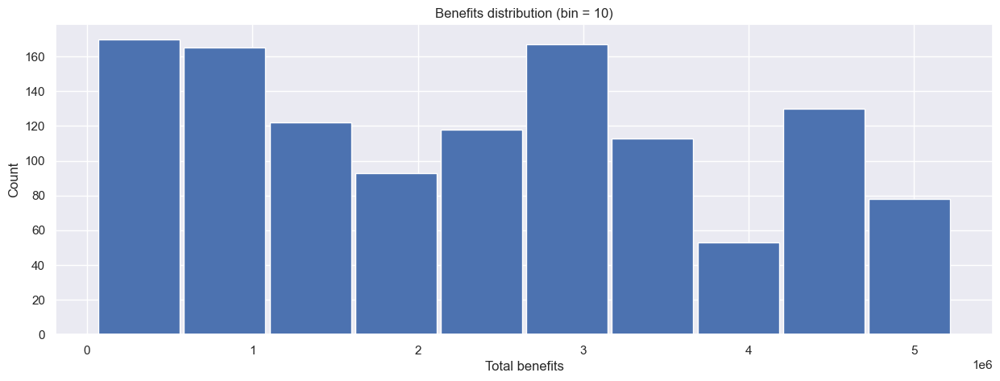

In [307]:
plt.hist(_benefit_list, rwidth=0.95)
plt.title("Benefits distribution (bin = 10)")
plt.xlabel("Total benefits")
plt.ylabel("Count")
plt.show()

# Unique benefit distribution

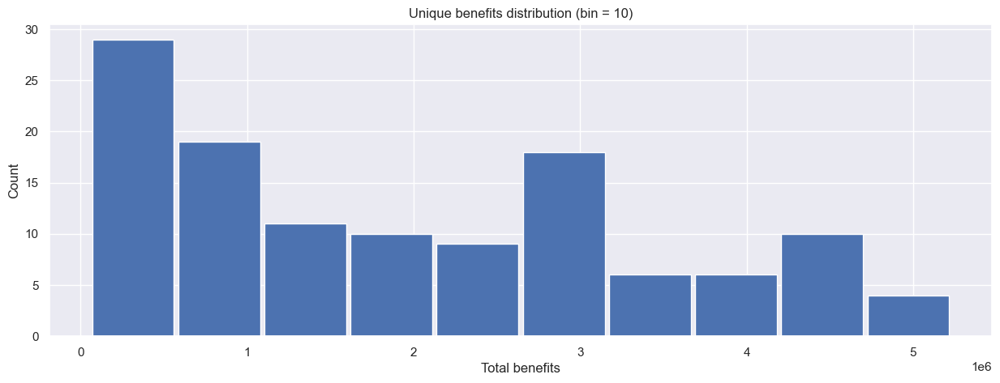

In [308]:
plt.hist(_total_benefit_unique, rwidth=0.95)
plt.title("Unique benefits distribution (bin = 10)")
plt.xlabel("Total benefits")
plt.ylabel("Count")
plt.show()

# Worst statements 
Include intermediate nodes

In [393]:
def _extract_worst(tree: dict, result: list, worst_benefit: int):
    if 'result' in tree:    # to skip root
        if tree['total_benefit'] == worst_benefit:
            result.append(tree['result'])
            
    
    for subtree in tree['next']:
        _extract_worst(subtree, result, worst_benefit)

In [394]:
worst_benefit = min(_benefit_list)
worst_statements_search_result = []

_extract_worst(search_result, worst_statements_search_result, worst_benefit)

In [400]:
len(worst_statements_search_result), worst_benefit

(11, 56139)

In [398]:
[w.keys() for w in worst_statements_search_result]

[dict_keys(['25', '27', '28', '30', '31', '34', '35', 'EB-26-29-32-33']),
 dict_keys(['25', '26', '28', '30', '31', '34', '35', 'EB-27-29-32-33']),
 dict_keys(['25', '27', '28', '29', '31', '34', '35', 'EB-26-30-32-33']),
 dict_keys(['25', '26', '27', '29', '31', '34', '35', 'EB-28-30-32-33']),
 dict_keys(['25', '26', '27', '28', '30', '31', '34', '35', 'EB-29-32-33']),
 dict_keys(['25', '26', '28', '30', '31', '34', '35', 'EB-27-29-32-33']),
 dict_keys(['25', '27', '28', '30', '31', '34', '35', 'EB-26-29-32-33']),
 dict_keys(['25', '26', '27', '28', '29', '31', '34', '35', 'EB-30-32-33']),
 dict_keys(['25', '26', '27', '29', '31', '34', '35', 'EB-28-30-32-33']),
 dict_keys(['25', '27', '28', '29', '31', '34', '35', 'EB-26-30-32-33']),
 dict_keys(['25', '26', '27', '28', '29', '30', '31', '34', '35', 'EB-32-33'])]

# Terminal nodes
= Can't be further merged

In [311]:
def extract_terminal_nodes(tree: dict, result: list):
    if len(tree['next']) > 0:
        for subtree in tree['next']:
            extract_terminal_nodes(subtree, result)
    else:
        result.append(tree['result'])

In [312]:
terminal_nodes = []

extract_terminal_nodes(search_result, terminal_nodes)

In [313]:
terminal_nodes

[{'25': [[],
   ['EB-28-30', 'EB-31-32', 'EB-26-29-33'],
   0.061239,
   99090,
   ['88', '95', '96', '97', '101', '102', '103', '87']],
  '27': [[],
   ['EB-26-29-33'],
   0.047481,
   2880404,
   ['18', '17', '15', '16', '1', '4']],
  '34': [['EB-26-29-33'], ['35'], 1.182939, 555294969, []],
  '35': [['34'], [], 0.407706, 1, []],
  'EB-28-30': [['25', 'EB-26-29-33'],
   ['EB-26-29-33'],
   0.23311700000000002,
   135789,
   ['150', '149', '147', '148', '125', '128'],
   ['28', '30'],
   1441548],
  'EB-31-32': [['25', 'EB-26-29-33'],
   ['EB-26-29-33'],
   0.235688,
   56139,
   ['186', '211', '210', '208', '209', '190'],
   ['31', '32'],
   719384],
  'EB-26-29-33': [['25', 'EB-28-30', '27', 'EB-31-32'],
   ['EB-31-32', 'EB-28-30', '34'],
   0.472087,
   569596,
   ['30', '24'],
   ['26', '29', '33'],
   261883]},
 {'25': [[],
   ['EB-26-29', 'EB-31-32', 'EB-28-30-33'],
   0.061239,
   99090,
   ['88', '95', '96', '97', '101', '102', '103', '87']],
  '27': [[],
   ['EB-26-29'],
   0

In [314]:
len(terminal_nodes)

798

# Unique Terminal nodes

NOTE: There can exist different statements with SAME benefits.

In [315]:
num_terminal_nodes = 0      # is unique?
benefit_with_mutliple_nodes = []

for total_benefit, infos in result.items():
    num_terminal_nodes += len(infos)
    if len(infos) > 0: 
        benefit_with_mutliple_nodes.append(total_benefit)

In [316]:
num_terminal_nodes

102

In [317]:
unique_terminal_nodes = {}

for b in benefit_with_mutliple_nodes:
    if b not in unique_terminal_nodes:
        unique_terminal_nodes[b] = []
    
    for infos in result[b]:
        if is_duplicated(unique_terminal_nodes[b], infos):
            continue
        unique_terminal_nodes[b].append(infos)


In [318]:
num_unique_terminal_nodes = 0
for b, i in unique_terminal_nodes.items():
    num_unique_terminal_nodes += len(i)

In [319]:
# terminal nodes are all unique
num_unique_terminal_nodes

102

# Build tree of search space

In [320]:
def _build_tree(tree: dict, result: dict):
    if "result" not in tree:    # root
        # result["statements"] = "_root"
        result["update"] = "_root"
    else:
        # result["statements"] = sorted(list(tree["result"].keys()))
        result["update"] = tree["update"]
    
    if tree["next"] is not None:
        result["subtree"] = []
        for subnode in tree["next"]:
            r = {}
            _build_tree(subnode, r)
            result["subtree"].append(r)

In [321]:
_tree = {}
_build_tree(search_result, _tree)

In [322]:
from pprint import pprint
pprint(_tree)

{'subtree': [{'subtree': [{'subtree': [{'subtree': [{'subtree': [],
                                                     'update': 'EB-26-29-33'},
                                                    {'subtree': [],
                                                     'update': 'EB-28-30-33'},
                                                    {'subtree': [],
                                                     'update': 'EB-31-32-33'}],
                                        'update': 'EB-31-32'},
                                       {'subtree': [{'subtree': [],
                                                     'update': 'EB-28-30-33'},
                                                    {'subtree': [],
                                                     'update': 'EB-26-29-32-33'}],
                                        'update': 'EB-26-29-32'},
                                       {'subtree': [{'subtree': [],
                                                     'update': 

# Extract subtree
Always traverse through first node.  

Followings denote upate (= merge statement)

In [323]:
# Under root
for st in _tree['subtree']:
    print(st['update'])

EB-26-29
EB-27-29
EB-26-30
EB-28-30
EB-26-32
EB-31-32
EB-29-33
EB-30-33
EB-32-33


In [324]:
# Under first node: EB-26-29
for st in _tree['subtree'][0]['subtree']:
    print(st['update'])

EB-28-30
EB-26-29-30
EB-31-32
EB-26-29-32
EB-30-33
EB-32-33
EB-26-29-33


In [325]:
# Under first-first node: EB-28-30
for st in _tree['subtree'][0]['subtree'][0]['subtree']:
    print(st['update'])

EB-31-32
EB-26-29-32
EB-32-33
EB-26-29-33
EB-28-30-33


In [326]:
# Under hop-3 node: EB-31-32
for st in _tree['subtree'][0]['subtree'][0]['subtree'][0]['subtree']:
    print(st['update'])

EB-26-29-33
EB-28-30-33
EB-31-32-33


In [327]:
# Under hop-4 node: EB-26-29-33
# Nothing == this is terminal node
for st in _tree['subtree'][0]['subtree'][0]['subtree'][0]['subtree'][0]['subtree']:
    print(st['update'])

# Visualize search space

In [328]:
def _build_graph_list(tree: dict, result: list, parent="root"):
    if 'result' in tree:
        tmp = {}
        statement = " | ".join(sorted(list(tree["result"].keys())))
        tmp["statements"] = statement
        tmp["update"] = tree["update"]
        tmp["total_benefit"] = tree["total_benefit"]
        tmp["parent"] = parent

        result.append(tmp)

        parent = statement
    
    if tree["next"] is not None:
        for subnode in tree["next"]:
            _build_graph_list(subnode, result, parent)

In [329]:
_graph_list = []

_build_graph_list(search_result, _graph_list)

In [330]:
for i, _g in enumerate(_graph_list):
    _g["node"] = i+1

In [331]:
graph = nx.Graph()
graph.add_node(0, total_benefit=0)

for i, _g in enumerate(_graph_list):
    graph.add_node(i+1, total_benefit=_g['total_benefit'])
    if _g["parent"] == "root":
        parent = 0
    else:
        for _g2 in _graph_list:
            if _g2["statements"] == _g["parent"]:
                parent = _g2["node"]
    
    graph.add_edge(parent, _g["node"], update=_g["update"])    #type:ignore

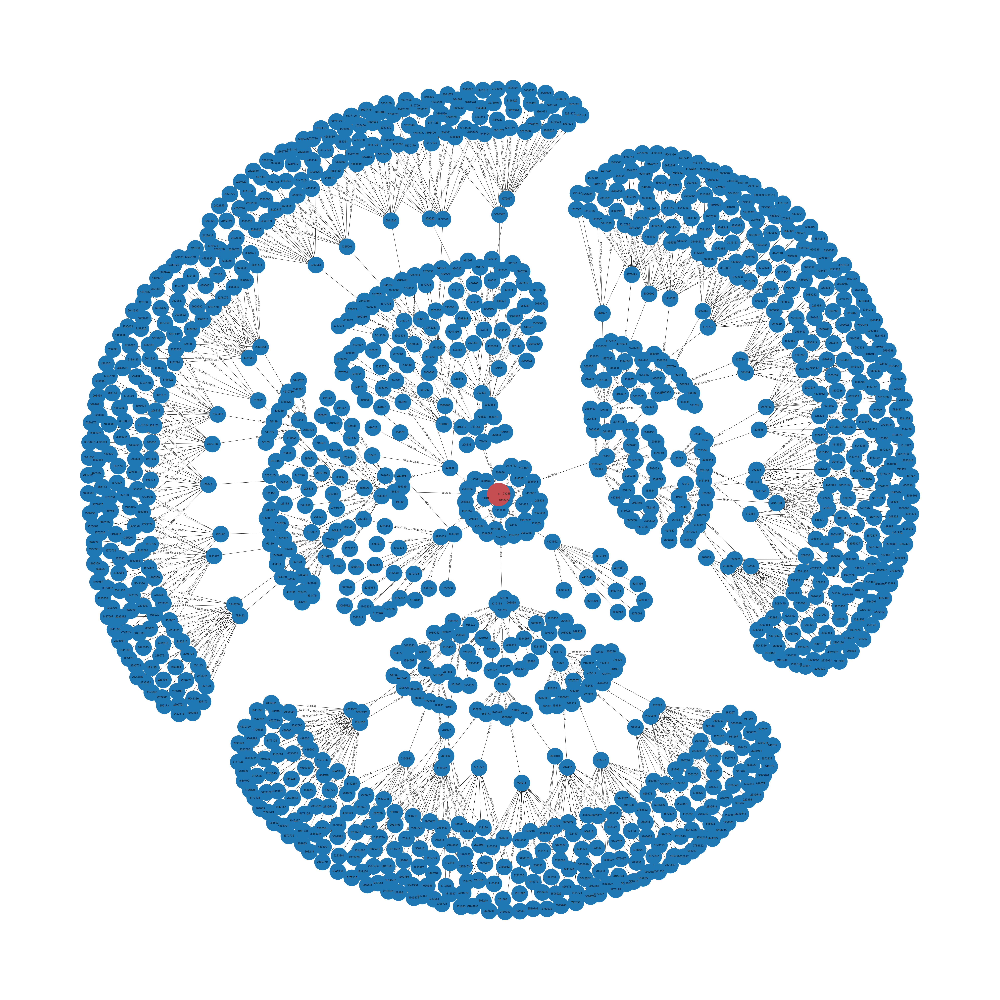

In [332]:
plt.figure(figsize=(60, 60))

# pos = nx.spring_layout(graph, seed=1234)
pos = nx.kamada_kawai_layout(graph)
nx.draw(graph, pos, node_size=5000)

node_labels = nx.get_node_attributes(graph,'total_benefit')
nx.draw_networkx_labels(graph, pos, labels = node_labels)
edge_labels = nx.get_edge_attributes(graph,'update')
nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, label_pos=0.5)

nx.draw_networkx_nodes(graph, pos, nodelist=[0], **{"node_size": 10000, "node_color": "r"})
# plt.savefig('this.png')
plt.show()

# Visualize search space 2

In [357]:
def _build_graph_list_with_hop(tree: dict, result: list, parent="root", hop=0):
    if 'result' in tree:
        tmp = {}
        statement = " | ".join(sorted(list(tree["result"].keys())))
        tmp["statements"] = statement
        tmp["update"] = tree["update"]
        tmp["total_benefit"] = int(tree["total_benefit"])
        tmp["parent"] = parent
        tmp["hop"] = hop

        result.append(tmp)

        parent = statement
    
    if tree["next"] is not None:
        for subnode in tree["next"]:
            _build_graph_list_with_hop(subnode, result, parent, hop+1)

In [358]:
_graph_list = []

_build_graph_list_with_hop(search_result, _graph_list)

In [359]:
for i, _g in enumerate(_graph_list):
    _g["node"] = i+1

In [360]:
graph = nx.Graph()
graph.add_node(0, total_benefit=0, hop=0)

for i, _g in enumerate(_graph_list):
    graph.add_node(i+1, total_benefit=_g['total_benefit'], hop=_g["hop"])
    if _g["parent"] == "root":
        parent = 0
    else:
        for _g2 in _graph_list:
            if _g2["statements"] == _g["parent"]:
                parent = _g2["node"]
    
    graph.add_edge(parent, _g["node"], update=_g["update"])    #type:ignore

In [364]:
from pyvis import network as net

g = net.Network(notebook=True)
g.from_nx(graph)
g.show("graph.html")
g.show_buttons(filter_=['physics'])

graph.html


# Visualize search space 3

In [377]:
color = ["red", "orange", "yellow", "green", "blue", "purple", "brown"]
# color = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']

node_colors = []
for k, v in nx.get_node_attributes(graph,'hop').items():
    node_colors.append(color[v])

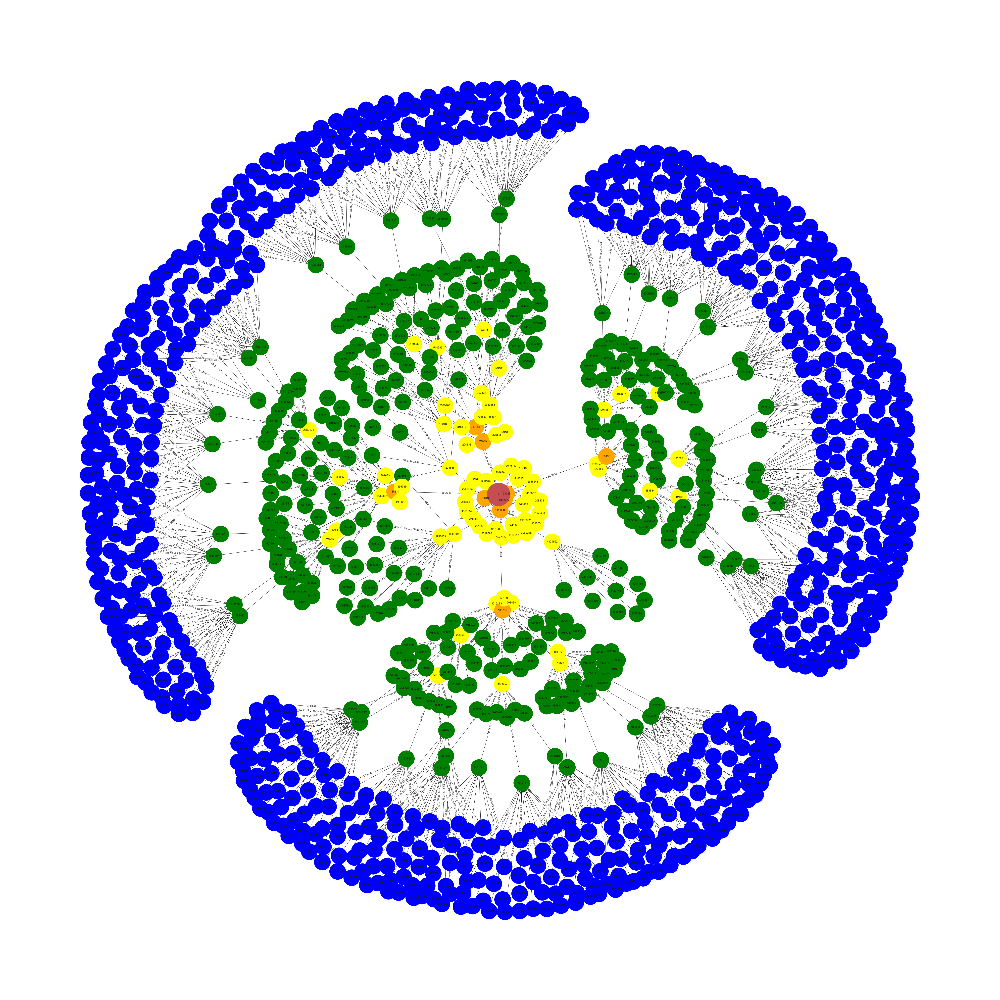

In [378]:


plt.figure(figsize=(60, 60))

# pos = nx.spring_layout(graph, seed=1234)
pos = nx.kamada_kawai_layout(graph)
nx.draw(graph, pos, node_size=5000, node_color=node_colors)

node_labels = nx.get_node_attributes(graph,'total_benefit')
nx.draw_networkx_labels(graph, pos, labels = node_labels)
edge_labels = nx.get_edge_attributes(graph,'update')
nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, label_pos=0.5)

nx.draw_networkx_nodes(graph, pos, nodelist=[0], **{"node_size": 10000, "node_color": "r"})
# plt.savefig('this.png')
plt.show()

# Performance comparison

In [335]:
import numpy as np
es = np.array([
    0.5873212814331055,
    0.5568654999951832,
    0.5905349254608154
])
greedy = np.array([
    0.008849143981933594,
    0.00899815559387207,
    0.009999752044677734
])

In [336]:
a = np.array([es, greedy]).reshape(-1, 1)
b = np.array(["Exhaustive search", "Greedy"]).repeat(3).reshape(-1, 1)
e = np.tile(np.array([1, 2, 3]), 2).reshape(-1, 1)

In [337]:
df = pd.DataFrame(np.concatenate([a, b, e], axis=1), columns=["Time", "Algorithm", "Iteration"])
df

,Time,Algorithm,Iteration
0,0.5873212814331055,Exhaustive search,1
1,0.5568654999951832,Exhaustive search,2
2,0.5905349254608154,Exhaustive search,3
3,0.008849143981933594,Greedy,1
4,0.00899815559387207,Greedy,2
5,0.009999752044677734,Greedy,3


In [338]:
df["Time"] = pd.to_numeric(df["Time"])

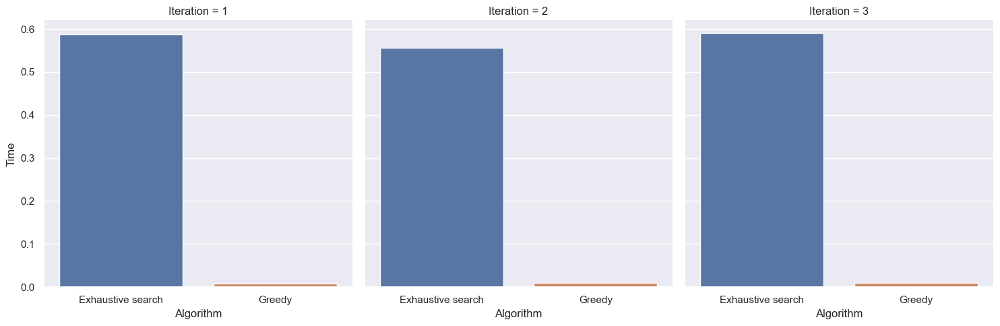

In [339]:
import seaborn as sns
s = sns.catplot(df, x="Algorithm", y="Time", col="Iteration", kind="bar")

# for ax in s.axes:
#     for p in ax.patches:
#         ax.annotate(p.value)

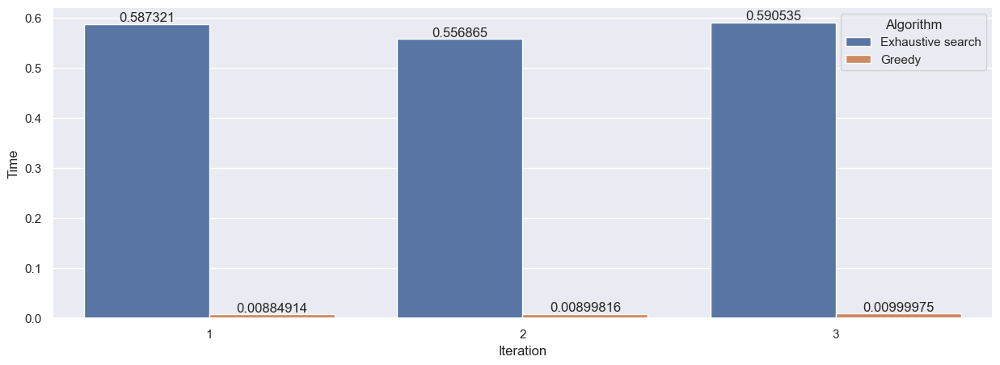

In [340]:
sns.set(rc={'figure.figsize':(15,5)})
s = sns.barplot(df, x="Iteration", y="Time", hue="Algorithm")

for i in s.containers:
    s.bar_label(i,)